<a href="https://colab.research.google.com/github/yrodriguezmd/Surgical_instruments/blob/main/Models/notebooks/Student_models/Model_M/Set_U1_Model_M_oct22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Labelled dataset = Set_S (Set_1_7)

Unlabelled dataset = Set_U1

Model_M 

In [ ]:
!wget https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
!bash install_colab.sh

In [ ]:
exit()

In [ ]:
import icevision

In [ ]:
from icevision.all import *
print('icevision v',icevision.__version__)
print('torch v',torch.__version__)
print('torchvision v',torchvision.__version__)

icevision v 0.10.0a1
torch v 1.9.0+cu111
torchvision v 0.10.0+cu111


Train Model_M using Set_S (Set_1_7)

In [ ]:
!ls Surgical_instruments/Sets/Set_S/subsets/Set_1_7

notebooks  README.md  test  train  valid  whole_set


In [ ]:
image_path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7/train')

img_files = get_image_files(image_path)

img = PIL.Image.open(img_files[601]) ##
img = img.convert('RGB')

#img.to_thumb(150,150)

In [ ]:
classes = ['Towel_clip', 'Castroviejo', 'Yankauer', 'Hemostat', 'Army_navy', 'Richardson', 'Potts', 'Iris', 'Bulldog', 'Forceps', 'Scalpel', 'Frazier', 'Needle', 'Weitlaner', 'Mayo_metz']
class_map = ClassMap(classes)
len(class_map)

16

Parse data

In [ ]:
path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7') # adjust if use git clone vs gdrive
#path = Path('gdrive/MyDrive/Surgical_instruments/Set_1_5.v1i.coco')

train_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'train/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'train/Set_1_5_annotations.coco.json',
    #img_dir = path/'train'
    img_dir = path/'train'
)

valid_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'valid/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'valid/Set_1_5_annotations.coco.json',
    #img_dir = path/'valid'
    img_dir = path/'valid'
)

In [ ]:
# dataset already split in annotation tool, maintain grouping

whole = SingleSplitSplitter()

train_records, *_ = train_parser.parse(data_splitter = whole)

valid_records, *_ = valid_parser.parse(data_splitter = whole)

  0%|          | 0/1323 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/677 [00:00<?, ?it/s]

  0%|          | 0/361 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/186 [00:00<?, ?it/s]

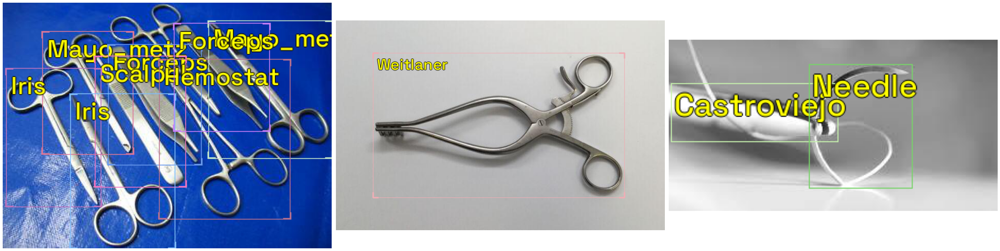

In [ ]:
show_records(train_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

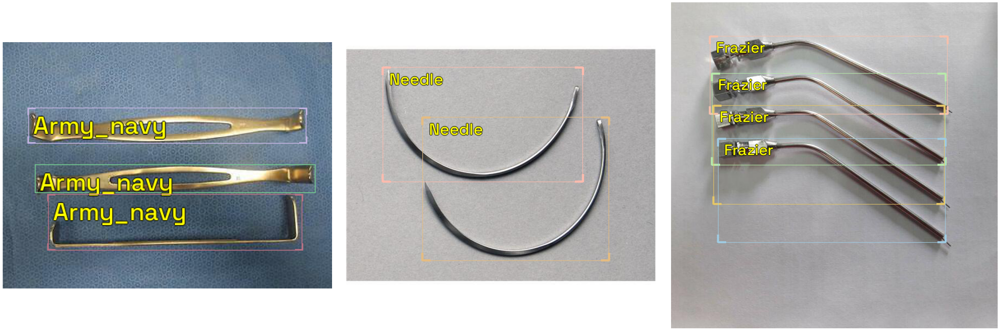

In [ ]:
show_records(valid_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

In [ ]:
presize = 512
image_size = 384

train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=presize), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size=image_size), tfms.A.Normalize()])

In [ ]:
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

In [ ]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

from icevision.models.checkpoint import *

model_type = models.mmdet.vfnet ##
backbone = model_type.backbones.resnet50_fpn_mstrain_2x##

model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(class_map),)# **extra_args)

In [ ]:
train_dl = model_type.train_dl(train_ds, batch_size = 16, num_workers = 4,
                               shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=16, num_workers = 4,
                               shuffle=False)

In [ ]:
from fastai.callback.wandb import *

wandb.init(project = 'Surgical_instruments', name = 'Model_M_', ##
           reinit = True)

COCOMetric,▁▃▄▅▆▆▆▆▅▆▅▆▇▆▇▆▇▇▇▇█▇█▇█▇▇▇████████████
epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
eps_0,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_1,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_2,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_3,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_4,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_5,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
eps_6,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr_0,▂▂▃▃▄▄▅▆▇▇███████▇▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁
lr_1,▂▂▃▃▄▄▅▆▇▇███████▇▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▁


In [ ]:
learn = model_type.fastai.learner(dls = [train_dl, valid_dl],
                                  model = model, metrics = metrics,#)
                                  cbs = WandbCallback(  )) ##

/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


SuggestedLRs(valley=0.0063095735386013985)

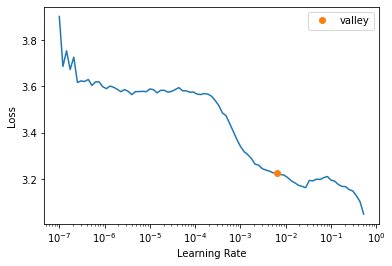

In [ ]:
learn.lr_find()

In [ ]:
learn.fine_tune(20,1e-04)##

Could not gather input dimensions
WandbCallback requires use of "SaveModelCallback" to log best model
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'Dataset' object has no attribute 'items'


epoch,train_loss,valid_loss,COCOMetric,time
0,3.276863,2.330316,0.060289,00:43


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,2.209926,2.148183,0.068593,00:47
1,2.106940,2.063704,0.074860,00:47
2,2.024488,1.992089,0.099430,00:47
3,1.951504,1.915978,0.134244,00:47
4,1.871041,1.833253,0.163020,00:47
5,1.795312,1.757792,0.216611,00:47
6,1.741678,1.789275,0.220102,00:46
7,1.658572,1.707954,0.252110,00:46
8,1.586729,1.652907,0.301880,00:46
9,1.520866,1.585221,0.350597,00:46


In [ ]:
learn.fine_tune(80,1e-04)##
# interval check for preds: 
# with intervening save model step skipped, and
# going straight to model.eval(), able to see preds

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.301931,1.553122,0.402531,00:43


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.285507,1.476217,0.439164,00:46
1,1.266320,1.495929,0.433387,00:46
2,1.259462,1.519534,0.421409,00:46
3,1.244338,1.500560,0.436898,00:46
4,1.222390,1.500304,0.449964,00:46
5,1.213067,1.494284,0.444598,00:46
6,1.217333,1.526972,0.433490,00:46
7,1.197842,1.478158,0.457846,00:46
8,1.192449,1.478180,0.457380,00:46
9,1.177447,1.516364,0.445200,00:46


In [ ]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.2, 
       'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,1);

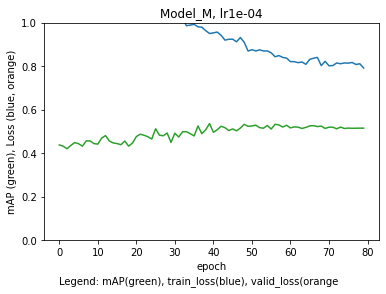

In [ ]:
plot_metrics(learn, 'Model_M, lr1e-04')

In [ ]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.2, 
       'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,2);

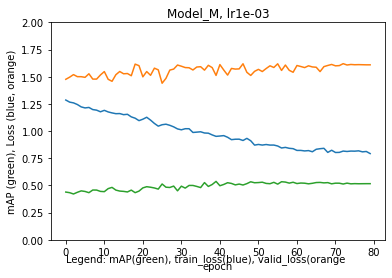

In [ ]:
plot_metrics(learn, 'Model_M, lr1e-03')

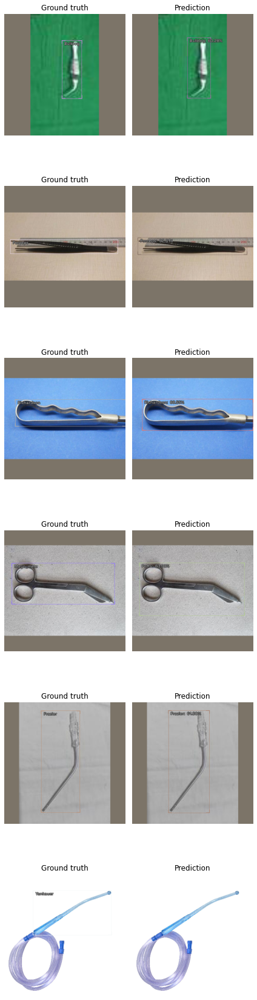

In [ ]:
model_type.show_results(model, valid_ds)

In [ ]:
from icevision.models import *

checkpoint_path = 'Model_M_vf_mAP51.6.pth'

save_icevision_checkpoint(model, 
                        model_name='mmdet.vfnet', ## 
                        backbone_name='resnet50_fpn_mstrain_2x', ##
                        classes =  train_parser.class_map.get_classes(), 
                        img_size=image_size, 
                        filename=checkpoint_path,
                        meta={'icevision_version': '0.9.1'})

# download model

Generate pseudolabels from Set_U1 using Teacher model Model_M

In [ ]:
#! git clone https://github.com/yrodriguezmd/Surgical_instruments.git

In [ ]:
# use gdrive
from google.colab import drive
drive.mount('/content/gdrive', force_remount = True)

Mounted at /content/gdrive


In [ ]:
!ls gdrive/MyDrive/Surgical_instruments
# Set_U1 with 1479 files

Models		  Set_1_5.v1i.coco  Set_2.v1i.coco
Set_1_3.v1i.coco  Set_1.v1i.coco    Set_U1


In [ ]:
classes = ['Towel_clip', 'Castroviejo', 'Yankauer', 'Hemostat', 'Army_navy', 'Richardson', 'Potts', 'Iris', 'Bulldog', 'Forceps', 'Scalpel', 'Frazier', 'Needle', 'Weitlaner', 'Mayo_metz']
class_map = ClassMap(classes)
len(class_map)

16

Inference on Set_S test_set

In [ ]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

from icevision.models.checkpoint import *

model_type = models.mmdet.vfnet ##
backbone = model_type.backbones.resnet50_fpn_mstrain_2x##

#model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(class_map),)# **extra_args)

In [ ]:
#from icevision.models import *

#checkpoint_path = 'Model_M_vf_mAP51.5.pth'

#checkpoint_and_model = model_from_checkpoint(checkpoint_path)

#model = checkpoint_and_model['model'] #Model_M
model.eval()
## no preds for Model_G_e for both Set_U1 and test_set

  0%|          | 0/185 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/93 [00:00<?, ?it/s]

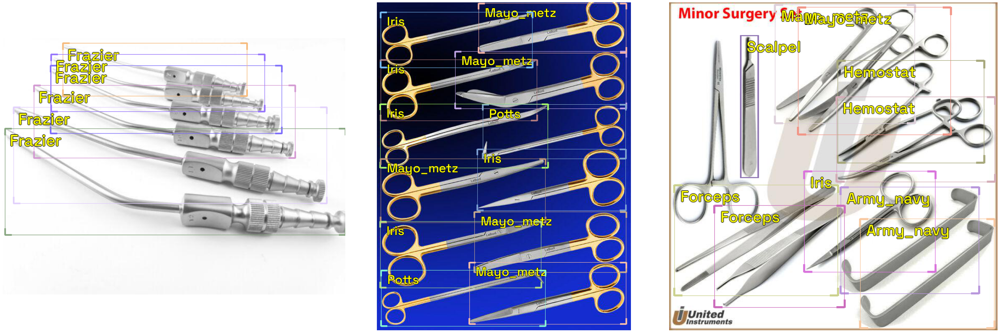

In [ ]:
path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7') # adjust if use git clone vs gdrive

test_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'test/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'train/Set_1_5_annotations.coco.json',
    #img_dir = path/'train'
    img_dir = path/'test')

whole = SingleSplitSplitter()

test_records, *_ = test_parser.parse(data_splitter = whole)

show_records(test_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

In [ ]:
classes = ['Towel_clip', 'Castroviejo', 'Yankauer', 'Hemostat', 'Army_navy', 'Richardson', 'Potts', 'Iris', 'Bulldog', 'Forceps', 'Scalpel', 'Frazier', 'Needle', 'Weitlaner', 'Mayo_metz']
class_map = ClassMap(classes)

In [ ]:
#imgs_array = [PIL.Image.open(file) for file in img_files]
#imgs_array = [PIL.Image.open(file) for file in test_records]

#imgs_array = [image.convert('RGB') for image in imgs_array]

img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

#infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)
infer_ds = Dataset(test_records, valid_tfms)#, class_map = class_map)

In [ ]:
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5) ##

  0%|          | 0/24 [00:00<?, ?it/s]

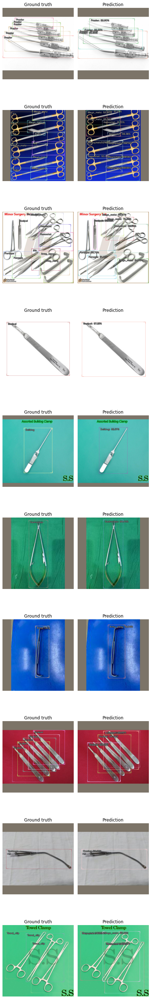

In [ ]:
#test
show_preds(preds = preds_saved[0:10])
# with detection threshold 0.5

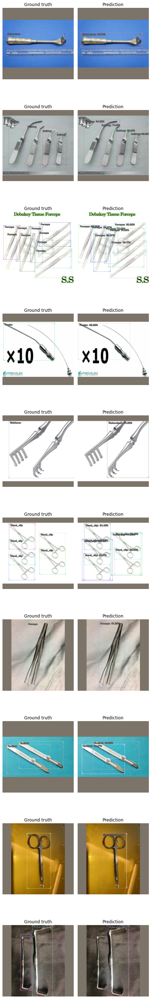

In [ ]:
#test
show_preds(preds = preds_saved[10:20])

Inference on Unlabelled Dataset Set_U1

Use Model_M to generate pseudolabels from Set_U1 

In [ ]:
## poor predictions
## problem solve
! git clone https://github.com/yrodriguezmd/Surgical_instruments.git

Cloning into 'Surgical_instruments'...
remote: Enumerating objects: 3545, done.
remote: Counting objects: 100% (152/152), done.
remote: Compressing objects: 100% (141/141), done.
remote: Total 3545 (delta 61), reused 9 (delta 9), pack-reused 3393
Receiving objects: 100% (3545/3545), 134.14 MiB | 27.37 MiB/s, done.
Resolving deltas: 100% (924/924), done.
Checking out files: 100% (4154/4154), done.


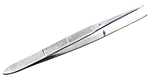

In [ ]:
#use gdrive (big files)
image_path = Path('gdrive/MyDrive/Surgical_instruments/Set_U1')

img_files = get_image_files(image_path)

img = PIL.Image.open(img_files[1401]) ##
img = img.convert('RGB')

img.to_thumb(150,150)

In [ ]:
imgs_array = [PIL.Image.open(file) for file in img_files]
#imgs_array = [PIL.Image.open(file) for file in test_records]

imgs_array = [image.convert('RGB') for image in imgs_array]

img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)
#infer_ds = Dataset(test_records, valid_tfms)#, class_map = class_map)

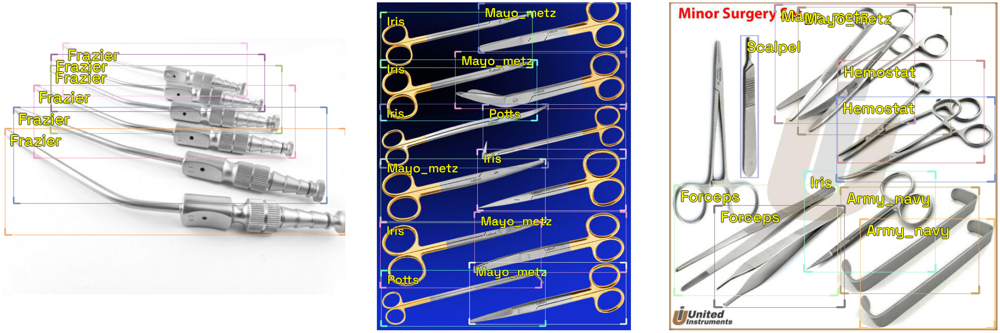

In [ ]:
show_records(test_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

In [ ]:
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5)

  0%|          | 0/370 [00:00<?, ?it/s]

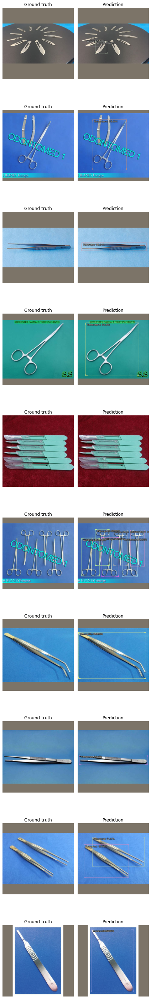

In [ ]:
show_preds(preds = preds_saved[0:10])

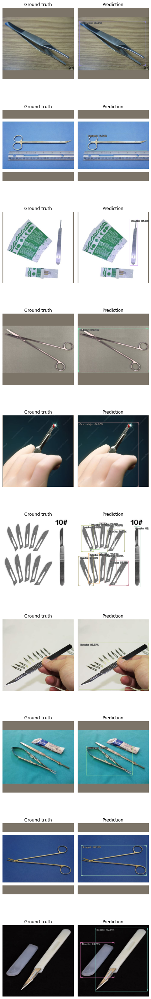

In [ ]:
show_preds(preds = preds_saved[10:20])

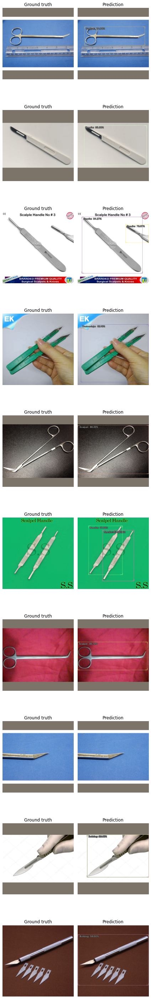

In [ ]:
show_preds(preds = preds_saved[20:30])

poor classification--> train more

In [ ]:
model.train()
learn.fine_tune(10, 1e-04)

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,0.857694,1.651689,0.494315,00:42


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,0.834150,1.662214,0.508799,00:45
1,0.840854,1.673176,0.510248,00:45
2,0.856757,1.704897,0.487255,00:46
3,0.885940,1.603313,0.527565,00:45
4,0.886376,1.510058,0.532479,00:45
5,0.887156,1.574802,0.525057,00:46
6,0.864658,1.599060,0.518331,00:45
7,0.857654,1.587165,0.512901,00:45
8,0.824925,1.563148,0.528067,00:45
9,0.833213,1.564561,0.522988,00:46


In [ ]:
model.eval()
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5)

  0%|          | 0/370 [00:00<?, ?it/s]

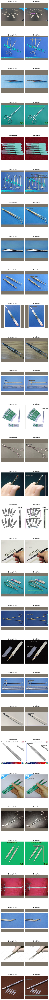

In [ ]:
# after extending training to 110 epochs
show_preds(preds = preds_saved[:30])

In [ ]:
checkpoint_path = 'Model_M_vf_mAP52.3.pth'

save_icevision_checkpoint(model, 
                        model_name='mmdet.vfnet', ## 
                        backbone_name='resnet50_fpn_mstrain_2x', ##
                        classes =  train_parser.class_map.get_classes(), 
                        img_size=image_size, 
                        filename=checkpoint_path,
                        meta={'icevision_version': '0.9.1'})

Still with poor class predictions, train for 10 more epochs

In [ ]:
model.train()
learn.fine_tune(10, 1e-04)

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,0.881156,1.713821,0.497399,00:42


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,0.824344,1.583580,0.526327,00:46
1,0.841862,1.541631,0.536740,00:45
2,0.849345,1.578203,0.505788,00:47
3,0.870690,1.628322,0.506087,00:46
4,0.868724,1.652528,0.504686,00:46
5,0.855868,1.640311,0.504172,00:46
6,0.856054,1.646118,0.502187,00:46
7,0.830614,1.569858,0.525962,00:46
8,0.811761,1.598536,0.511538,00:46
9,0.803270,1.591890,0.518267,00:46


In [ ]:
model.eval()
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5)

  0%|          | 0/370 [00:00<?, ?it/s]

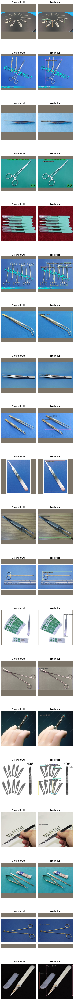

In [ ]:
# after extending training to 120 epochs
show_preds(preds = preds_saved[:20])

verify results with test_set

In [ ]:
#imgs_array = [PIL.Image.open(file) for file in img_files]
#imgs_array = [PIL.Image.open(file) for file in test_records]

#imgs_array = [image.convert('RGB') for image in imgs_array]

img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

#infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)
infer_ds = Dataset(test_records, valid_tfms)#, class_map = class_map)

In [ ]:
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved_test = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5) ##

  0%|          | 0/24 [00:00<?, ?it/s]

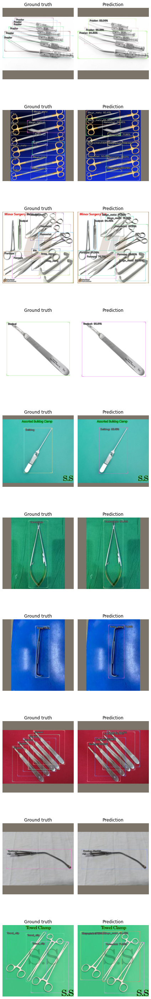

In [ ]:
show_preds(preds = preds_saved_test[:10])
# acceptable results with test, but poor with unlabelled data

Generate annotation file

In [ ]:
for pred in preds_saved:
  pred.add_component(FilepathRecordComponent())

for _ in range(len(preds_saved)): 
  preds_saved[_].set_filepath(img_files[_]) 

conv = convert_preds_to_coco_style(preds_saved) 

In [ ]:
add_info = {
    "info": {
        "year": "2021",
        "version": "1",
        "description": "Exported from roboflow.ai",
        "contributor": "",
        "url": "https://public.roboflow.ai/object-detection/undefined",
        "date_created": "2021-10-05T20:13:09+00:00"
    },
    "licenses": [
        {
            "id": 1,
            "url": "https://creativecommons.org/licenses/by/4.0/",
            "name": "CC BY 4.0"
        }
    ],
    "categories": [
        {
            "id": 0,
            "name": "instruments",
            "supercategory": "none"
        },
        {
            "id": 1,
            "name": "Army_navy",
            "supercategory": "Retractor"
        },
        {
            "id": 2,
            "name": "Bulldog",
            "supercategory": "Clamp"
        },
        {
            "id": 3,
            "name": "Castroviejo",
            "supercategory": "Needle_holder"
        },
        {
            "id": 4,
            "name": "Forceps",
            "supercategory": "Forceps"
        },
        {
            "id": 5,
            "name": "Frazier",
            "supercategory": "Suction"
        },
        {
            "id": 6,
            "name": "Hemostat",
            "supercategory": "Clamp"
        },
        {
            "id": 7,
            "name": "Iris",
            "supercategory": "Scissors"
        },
       {
            "id": 8,
            "name": "Mayo_metz",
            "supercategory": "Scissors"
        },
        {
            "id": 9,
            "name": "Needle",
            "supercategory": "Needle"
        },
        {
            "id": 10,
            "name": "Potts",
            "supercategory": "Scissors"
        },
        {
            "id": 11,
            "name": "Richardson",
            "supercategory": "Retractor"
        },
        {
            "id": 12,
            "name": "Scalpel",
            "supercategory": "Scalpel"
        },
        {
            "id": 13,
            "name": "Towel_clip",
            "supercategory": "Clamp"
        },
        {
            "id": 14,
            "name": "Weitlaner",
            "supercategory": "Retractor"
        },
        {
            "id": 15,
            "name": "Yankauer",
            "supercategory": "Suction"
        }
    ]
}

In [ ]:
pseudo_1 = {**add_info, **conv} ##

f = open('pseudo_1.json','w') ##
f.write(str(pseudo_1)) ##
f.close()
##  edit ' to ": pseudo_1_

Parse labelled and pseudolabelled data.

In [ ]:
#labelled data
! git clone https://github.com/yrodriguezmd/Surgical_instruments.git

In [139]:
!ls gdrive/MyDrive/Surgical_instruments/

Models		  Set_1_5.v1i.coco  Set_2.v1i.coco
Set_1_3.v1i.coco  Set_1.v1i.coco    Set_U1


In [140]:
# Use Set_1_7 labelled data
labelled_path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7')
pseudolabelled_path = Path('gdrive/MyDrive/Surgical_instruments/Set_U1')

lab_train_parser = parsers.COCOBBoxParser(
    annotations_filepath = labelled_path/'train/Set_1_7_annotations.coco.json',
    img_dir = labelled_path/'train'
)

ps_train_parser = parsers.COCOBBoxParser(
    annotations_filepath = 'pseudo_1_.json', #uploaded
    img_dir = pseudolabelled_path
)

valid_parser = parsers.COCOBBoxParser(
    annotations_filepath = labelled_path/'valid/Set_1_7_annotations.coco.json',
    img_dir = labelled_path/'valid'
)

In [141]:
whole = SingleSplitSplitter()

train_records, *_ = lab_train_parser.parse(data_splitter = whole)

train_records_ps, *_ = ps_train_parser.parse(data_splitter = whole)

valid_records, *_ = valid_parser.parse(data_splitter = whole)

  0%|          | 0/1323 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/677 [00:00<?, ?it/s]

  0%|          | 0/3280 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/1368 [00:00<?, ?it/s]

AUTOFIX-SUCCESS - (record_id: 13) - Clipping bbox ymax from 313.84659 to image height 312 (Before: <BBox (xmin:5.7618713, ymin:79.92746, xmax:380.4242513, ymax:313.84659)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 23) - Clipping bbox xmax from 380.471085 to image width 350 (Before: <BBox (xmin:16.187515, ymin:61.28041, xmax:380.471085, ymax:373.05263)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 23) - Clipping bbox ymax from 373.05263 to image height 350 (Before: <BBox (xmin:16.187515, ymin:61.28041, xmax:350, ymax:373.05263)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 31) - Clipping bbox ymax from 319.634434 to image height 316 (Before: <BBox (xmin:129.63193, ymin:202.35175, xmax:310.086, ymax:319.634434)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 33) - Clipping bbox ymax from 253.07422000000003 to image height 174 (Before: <BBox (xmin:5.0390778, ymi

  0%|          | 0/361 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/186 [00:00<?, ?it/s]

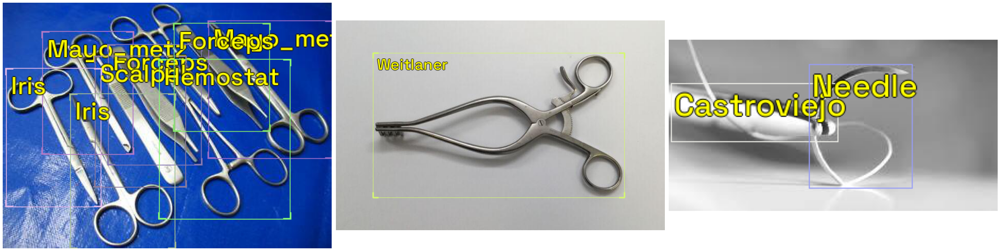

In [142]:
show_records(train_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

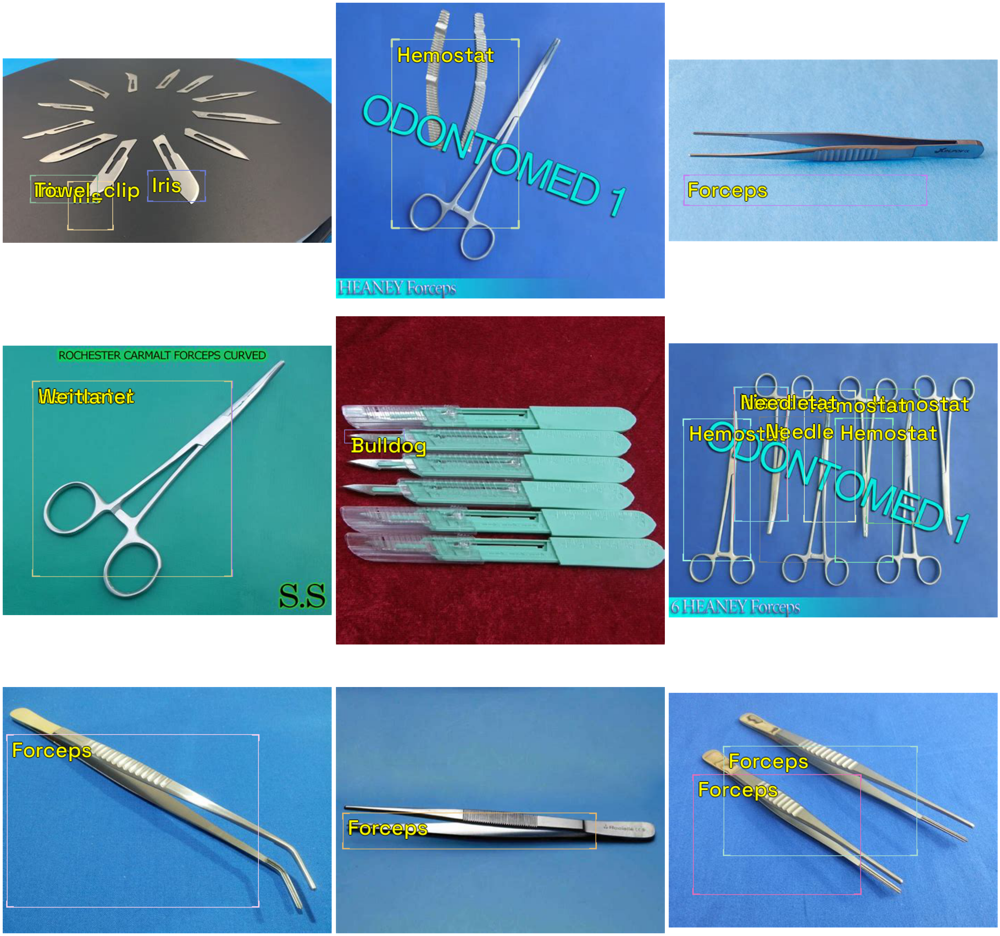

In [145]:
show_records(train_records_ps[0:9],ncols=3, font_size=30, label_color = '#ffff00')
# more reasonable compared to preds_saved?!

Merge labelled records and pseudolabelled records

In [146]:
merged_train_records = torch.utils.data.ConcatDataset([train_records, train_records_ps])
print(len(train_records))
print(len(train_records_ps))
print(len(merged_train_records))

677
1368
2045


In [148]:
1- ( (1479 - 1368) / 1479)
# 92% of the unlabelled images have pseudolabels

0.9249492900608519

In [174]:
f = open('merged_train_records','w') 
f.write(str(merged_train_records)) 
f.close()

Merge unannotated images from Set_U1 to Set_U2

In [149]:
preds_saved[0].pred

BaseRecord

common: 
	- Filepath: gdrive/MyDrive/Surgical_instruments/Set_U1/Unlabelled01073.jpg
	- Img: None
	- Image size ImgSize(width=384, height=384)
	- Img: 384x384x3 <np.ndarray> Image
	- Record ID: 0
detection: 
	- Class Map: <ClassMap: {'background': 0, 'Towel_clip': 1, 'Castroviejo': 2, 'Yankauer': 3, 'Hemostat': 4, 'Army_navy': 5, 'Richardson': 6, 'Potts': 7, 'Iris': 8, 'Bulldog': 9, 'Forceps': 10, 'Scalpel': 11, 'Frazier': 12, 'Needle': 13, 'Weitlaner': 14, 'Mayo_metz': 15}>
	- Labels: [7, 7, 7, 13]
	- Scores: [    0.90459     0.66428     0.55014     0.51469]
	- BBoxes: [<BBox (xmin:40.46257019042969, ymin:168.257568359375, xmax:136.4140167236328, ymax:208.45103454589844)>, <BBox (xmin:94.69554901123047, ymin:177.61798095703125, xmax:158.8835906982422, ymax:247.94129943847656)>, <BBox (xmin:209.93145751953125, ymin:161.52713012695312, xmax:291.4521179199219, ymax:206.20155334472656)>, <BBox (xmin:40.46257019042969, ymin:168.257568359375, xmax:136.4140167236328, ymax:208.451

In [150]:
len(preds_saved)

1478

In [151]:
Set_U1_a = [] # retained images (no pseudolabels)
for x in range(len(preds_saved)):
  if preds_saved[x].pred.detection.labels ==[]:
    Set_U1_a.append(preds_saved[x].pred.common.filepath)


In [166]:
Set_U1_a[0]

Path('gdrive/MyDrive/Surgical_instruments/Set_U1/Unlabelled01090.jpg')

In [153]:
imgs_retained = [PIL.Image.open(file) for file in Set_U1_a]

retained_ds = Dataset.from_images(imgs_retained, valid_tfms, class_map = class_map)

retained_ds

<Dataset with 110 items>

In [155]:
len(train_records_ps) + len(retained_ds)
# approximates dataset size (1479)

1478

In [159]:
retained_ds_ = Dataset(imgs_retained, valid_tfms,)# class_map = class_map)
retained_ds_

<Dataset with 110 items>

In [161]:
#torch.save(retained_ds, 'retained_ds.pt')
#download locally
# doesn't seem to work

In [162]:
#torch.load('retained_ds.pt')

<Dataset with 110 items>

In [168]:
f = open('Set_U1_a','w') 
f.write(str(Set_U1_a)) 
f.close()
# download locally

Continuing on to Set_U2

In [169]:
!ls gdrive/MyDrive/Surgical_instruments
#Set_U2 with 1364 images

Models		  Set_1_5.v1i.coco  Set_2.v1i.coco  Set_U2
Set_1_3.v1i.coco  Set_1.v1i.coco    Set_U1


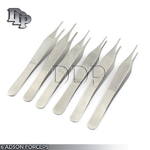

In [170]:
images = Path('gdrive/MyDrive/Surgical_instruments/Set_U2')

img_files = get_image_files(images)

img = PIL.Image.open(img_files[1001])
#img = img.convert('RGB')

img.to_thumb(150,150)

In [171]:
# same classes

imgs_array = [PIL.Image.open(file) for file in img_files]

imgs_array = [image.convert('RGB') for image in imgs_array]

img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


In [172]:
# merge new unlabelled dataset Set_U2 with retained unlabelled images from Set_U1
infer_ds_ = torch.utils.data.ConcatDataset([infer_ds, retained_ds])

In [173]:
len(infer_ds_)

1474

Train Teacher Model_M using merged labelled + pseudolabelled data, to generate Student Model_M1

will need files:

merged files for training Model_M1:
pseudo annotations for Set_U1 (pseudo_1_.json)

files for merging with Set_U2:
Set_U1a (path files)